In [69]:
import pandas as pd
import numpy as np
import csv
import os
from datetime import datetime
import matplotlib.pyplot as plt
import random
import seaborn as sns

In [70]:
#Activate the first option if whole column width is necessary and the second to make all columns visible
#pd.set_option('display.max_colwidth', -1)
pd.set_option('display.max_columns', 999)
pd.set_option('display.max_rows', 999)

## I. Import the transformed datasets

In [71]:
#Get the three reports and store them into dataframes. Check what columns are included in the file
factors = pd.read_csv('factors_clean.csv', index_col = 0)
base = pd.read_csv('Det_curve_set2.csv', index_col = 0)

print(factors.columns)
print(base.columns)

Index(['feature_id', 'survey_feat_end', 'LCRV', 'LCTM', 'LEDR', 'LFAL', 'LGRD',
       'LLRT', 'LLTD', 'LLTM', 'LLTX', 'LRRT', 'LRTM', 'LRTC', 'LRTV', 'LV10',
       'LV3', 'FinancialY'],
      dtype='object')
Index(['feature_id', 'FinancialY', 'sub_obs_val_max', 'sub_obs_val_std',
       'Carriageway Scheme', 'Drainage', 'Drainage CAT 2',
       'Localised Patching', 'Long Term Structural Maintenance',
       'Major Patching', 'Microasphalt', 'Reconstruction', 'Recycling',
       'Super Cat 2', 'Surface Dressing', 'Surface Inlay', 'Surface Overlay',
       'Surface Preservative', 'Thin Surfacing', 'Years_since', 'CCD1', 'CCD3',
       'CCD4', 'CFL', 'CFS1', 'CKD2', 'CKD3', 'CMD3', 'CMUD', 'CPH2', 'CPH3',
       'CPH4', 'CPH7', 'CSH1', 'DCF1', 'DCF2', 'DCF3', 'DPD1', 'DPD2', 'GUL',
       'NZU', 'PDAM', 'RICE', 'SFL', 'SPL', 'SPLE', 'Prev_RCI', 'SURF', 'BEDR',
       'Month', 'hierarchy', 'distance', 'road_type_hw', 'urban_rural',
       'surf_type', 'width', 'sub_obs_val_avg', 'weight

### I. Merge the factors with the base

In [72]:
factors.tail(500)

,feature_id,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3,FinancialY
30098,C42/30,2018-09-29 16:06:00.000,345.900,0.735,0.0265,3.15,1.10,3.15,0.870,0.485,0.630,3.30,0.435,0.00,-3.715,12.020,1.040,2019
30099,C43/10,2018-09-29 16:34:00.000,30.650,0.550,0.0370,2.00,0.00,1.50,0.880,0.530,0.660,2.00,0.520,0.00,4.100,30.220,3.330,2019
30100,C43/110,2018-09-29 15:58:00.000,1198.880,0.550,0.0500,2.50,1.10,3.50,1.060,0.620,0.770,4.90,0.720,0.00,19.030,10.070,2.670,2019
30101,C43/120,2018-09-29 15:58:00.000,139.630,0.595,0.0695,2.40,0.70,5.20,0.780,0.410,0.555,3.90,0.500,0.00,4.035,11.705,2.855,2019
30102,C43/130,2018-09-29 15:54:00.000,842.420,0.260,0.0340,4.60,0.40,3.65,0.390,0.180,0.290,2.95,0.220,0.00,-2.780,12.890,2.650,2019
30103,C43/140,2018-09-29 15:54:00.000,342.190,0.560,0.0610,2.95,0.30,4.80,1.085,0.595,0.750,1.75,0.485,0.00,5.385,41.450,5.170,2019
30104,C43/150,2018-09-29 15:54:00.000,7.305,0.585,0.0685,2.00,0.30,2.80,0.845,0.440,0.590,0.30,0.400,0.00,-12.565,18.680,3.020,2019
30105,C43/20,2018-09-29 16:45:00.000,348.970,0.570,0.0230,2.90,0.40,2.30,0.730,0.500,0.760,1.10,0.530,0.00,-2.340,17.380,2.060,2019
30106,C44/10,2018-09-28 09:50:00.000,5.520,0.760,0.1110,2.10,1.00,4.70,0.940,0.540,0.780,0.90,0.560,0.00,-7.910,17.340,3.680,2019
30107,C45/10,2018-09-28 08:06:00.000,266.285,0.300,0.0145,2.80,0.55,4.20,1.100,0.620,0.835,0.90,0.230,0.00,4.755,16.380,1.500,2019


In [73]:
#Add the RCI factors to the general set:
initial = base.merge(factors,'left',on=['feature_id', 'FinancialY'],left_index = True)
initial.reset_index(drop= True, inplace = True)

In [74]:
#initial.loc[initial['feature_id']=='A4251/270']
initial.head(100)

,feature_id,FinancialY,sub_obs_val_max,sub_obs_val_std,Carriageway Scheme,Drainage,Drainage CAT 2,Localised Patching,Long Term Structural Maintenance,Major Patching,Microasphalt,Reconstruction,Recycling,Super Cat 2,Surface Dressing,Surface Inlay,Surface Overlay,Surface Preservative,Thin Surfacing,Years_since,CCD1,CCD3,CCD4,CFL,CFS1,CKD2,CKD3,CMD3,CMUD,CPH2,CPH3,CPH4,CPH7,CSH1,DCF1,DCF2,DCF3,DPD1,DPD2,GUL,NZU,PDAM,RICE,SFL,SPL,SPLE,Prev_RCI,SURF,BEDR,Month,hierarchy,distance,road_type_hw,urban_rural,surf_type,width,sub_obs_val_avg,weighted_av,perc85,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3
0,B486/20,2009,50.00,17.100354,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.00,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,27.968000,24.046409,47.0845,2008-09-20 23:59:59.000,418.445,0.285,0.0090,1.90,0.85,4.65,0.530,0.345,0.420,4.75,0.350,0.00,-6.815,6.105,0.830
1,B486/20,2010,128.70,30.767874,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.00,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,82.246000,72.053646,108.7225,2009-10-20 23:59:59.000,-871.210,0.300,0.0780,0.70,-1.35,5.00,0.555,0.225,0.345,2.55,0.235,0.55,17.330,17.300,3.850
2,B486/20,2011,50.00,14.081330,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,128.70,GYCK,GYCK,3.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,29.785455,20.360878,41.6650,2010-10-07 16:24:00.000,392.890,0.400,0.0150,1.90,1.10,4.00,0.540,0.300,0.400,4.10,0.320,0.00,-12.530,5.110,1.080
3,B486/20,2012,104.18,28.185490,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.00,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,43.430909,42.949916,66.2700,2011-12-04 23:59:59.000,639.070,0.410,0.0000,1.80,0.80,8.10,0.620,0.360,0.460,0.30,0.330,0.00,-5.510,8.110,1.090
4,B486/20,2013,54.74,14.952653,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,104.18,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,14.207273,16.742961,19.1000,2013-02-03 13:58:00.000,-583.900,0.360,0.0000,1.80,-0.80,2.70,0.640,0.430,0.530,3.40,0.410,0.00,-3.500,9.540,1.510
5,B486/20,2014,50.00,17.027742,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,54.74,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,26.135000,22.786151,45.9155,2013-12-06 23:59:59.000,518.385,0.375,0.0290,2.05,0.70,5.05,0.580,0.340,0.435,1.85,0.300,0.00,-26.435,6.740,0.925
6,B486/20,2015,88.51,25.328630,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.00,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,35.518182,40.597503,57.2150,2015-01-29 09:23:00.000,-327.230,0.350,0.0000,0.70,-0.90,1.90,0.570,0.380,0.470,1.90,0.450,0.00,5.560,14.690,1.390
7,B486/20,2016,37.30,11.320340,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,88.51,GYCK,GYCK,0.0,SD Secondary Distributor,98.0,Single 2-Lane Carriageway,Urban,BITM,8.34,17.731000,12.056656,23.8

In [75]:
initial['LCRV'].isnull().sum()
#initial.shape

467

In [76]:
initial.loc[initial['LCRV'].isnull()]

,feature_id,FinancialY,sub_obs_val_max,sub_obs_val_std,Carriageway Scheme,Drainage,Drainage CAT 2,Localised Patching,Long Term Structural Maintenance,Major Patching,Microasphalt,Reconstruction,Recycling,Super Cat 2,Surface Dressing,Surface Inlay,Surface Overlay,Surface Preservative,Thin Surfacing,Years_since,CCD1,CCD3,CCD4,CFL,CFS1,CKD2,CKD3,CMD3,CMUD,CPH2,CPH3,CPH4,CPH7,CSH1,DCF1,DCF2,DCF3,DPD1,DPD2,GUL,NZU,PDAM,RICE,SFL,SPL,SPLE,Prev_RCI,SURF,BEDR,Month,hierarchy,distance,road_type_hw,urban_rural,surf_type,width,sub_obs_val_avg,weighted_av,perc85,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3
477,C153/10,2011,141.02,26.882215,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,125.510,WHCK,WHCK,0.0,L2 Local Access,561.0,Single 2-Lane Carriageway,Rural,BITM,11.710000,57.033889,38.376807,67.8605,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
487,C74/150,2011,201.08,37.784937,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,161.380,GSG,LMBE,5.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.690000,28.125526,32.852215,66.7870,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
547,C54/38,2011,185.51,34.194799,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,149.255,THAM,THAM,0.0,L1 Local Distributor,620.0,Single 2-Lane Carriageway,Urban,BITM,8.890000,25.284032,21.902637,59.8500,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
577,C51/50,2011,168.00,34.159969,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,GSG,WHCK,0.0,L2 Local Access,1769.0,Single 2-Lane Carriageway,Rural,BITM,6.020000,31.943200,34.009848,69.7200,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
597,C46/20,2011,146.40,31.856354,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,150.200,WHCK,WHCK,0.0,L1 Local Distributor,1141.0,Single 2-Lane Carriageway,Rural,BITM,4.850000,29.210435,27.695181,59.7600,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
607,C15/130,2011,113.60,34.585017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,TILL,WHCK,0.0,L2 Local Access,414.0,Single 2-Lane Carriageway,Rural,BITM,4.550000,28.476098,36.512857,73.3300,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
677,C50/35,2011,141.00,36.060736,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,173.000,GSG,WHCK,0.0,L2 Local Access,123.0,Single 2-Lane Carriageway,Rural,BITM,7.170000,63.126154,63.829558,95.8800,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
727,C165/155,2011,37.40,6.686618,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,58.700,WHCK,WHCK,0.0,L2 Local Access,1323.0,Single 2-Lane Carriageway,Urban,BITM,9.210000,2.424722,2.991134,1.8510,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
747,C46/210,2011,208.02,49.563116,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,220.055,TILL,WHCK,0.0,L1 Local Distributor,1739.0,Single 2-Lane Carria

In [77]:
#Set null scores to be the average between the closest values
for i in range(1,len(initial)-1):
    score = initial.iloc[i,-15]
    feat = initial.iloc[i,0]
    if pd.isnull(score)==True:
        prev = initial.iloc[i-1,-15]
        works =initial.iloc[i-1,5:19].sum()
        factors = initial.iloc[i-1,-15:-1]
        postfact = initial.iloc[i+1,-15:-1]
        if (initial.iloc[i-1,0]==feat):
            if (pd.isnull(prev)==False):
                if (works==0):
                    initial.iloc[i,-15:-1] = factors
                    print(i)
                else:
                    continue
  

477
487
547
597
677
727
747
777
817
907
937
1048
1098
1108
1208
1228
1254
1278
1288
1308
1328
1428
1488
1498
1528
1628
1668
1698
1758
1778
1828
1908
1938
1949
1999
2069
2109
2209
2459
2469
2479
2559
2569
2579
2669
2749
2769
2879
2889
2929
2939
2999
3059
3087
3132
3155
3195
3395
3641
3668
3737
3782
3852
3929
4196
4442
4498
4507
4623
4648
4720
4993
5254
5309
5404
5431
5950
6119
6282
6377
6386
6498
6589
6598
6800
6841
6868
6980
7076
7094
7153
7162
7253
7398
7468
7598
7955
7991
8176
8628
8655
8718
8978
8996
9005
9164
9230
9277
9380
9493
9544
9580
9611
10034
10080
10107
10143
10174
10215
10419
10428
10535
10630
10684
10764
10855
10950
11035
11170
11245
11348
11357
11388
11392
11397
11427
11468
11509
11698
11716
11775
12092
12101
12155
12173
12404
12851
12860
13046
13050
13077
13135
13203
13248
13293
13311
13510
13568
13619
13700
13771
13857
13963
14107
14131
14210
14219
14241
14327
14386
14404
14440
14521
14539
14548
14620
14743
14919
14937
15327
15354
15381
15551
15561
15592
15662
15839
16

In [82]:
#initial.loc[initial['LCRV'].isnull()]
initial['LCRV'].isnull().sum()

0

In [80]:
initial = initial.loc[~initial['LCRV'].isnull()]

In [81]:
initial.shape

(24261, 75)

In [86]:
initial.loc[initial['sub_obs_val_avg']==0]

,feature_id,FinancialY,sub_obs_val_max,sub_obs_val_std,Carriageway Scheme,Drainage,Drainage CAT 2,Localised Patching,Long Term Structural Maintenance,Major Patching,Microasphalt,Reconstruction,Recycling,Super Cat 2,Surface Dressing,Surface Inlay,Surface Overlay,Surface Preservative,Thin Surfacing,Years_since,CCD1,CCD3,CCD4,CFL,CFS1,CKD2,CKD3,CMD3,CMUD,CPH2,CPH3,CPH4,CPH7,CSH1,DCF1,DCF2,DCF3,DPD1,DPD2,GUL,NZU,PDAM,RICE,SFL,SPL,SPLE,Prev_RCI,SURF,BEDR,Month,hierarchy,distance,road_type_hw,urban_rural,surf_type,width,sub_obs_val_avg,weighted_av,perc85,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3
1893,B656/10,2016,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,32.650,WHCK,WHCK,0.0,SD Secondary Distributor,155.00,Single 2-Lane Carriageway,Rural,BITM,13.040000,0.0,0.0,0.0,2015-11-19 09:26:00.000,142.570,0.550,0.0215,-0.30,-4.95,2.50,1.040,0.690,0.880,4.20,0.580,0.00,-4.155,11.040,1.060
2017,C167/60,2019,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.000,WHCK,WHCK,9.0,L1 Local Distributor,119.00,Single 2-Lane Carriageway,Urban,BITM,18.620000,0.0,0.0,0.0,2018-09-30 14:31:00.000,283.150,0.980,0.0400,3.50,-0.60,2.20,0.950,0.800,1.040,1.90,0.900,0.00,0.150,5.140,1.660
2575,C165/150,2017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.000,WHCK,WHCK,0.0,L1 Local Distributor,109.00,Single 2-Lane Carriageway,Urban,BITM,12.360000,0.0,0.0,0.0,2016-10-04 09:17:00.000,50.840,0.760,0.0430,1.90,-1.50,2.60,1.370,0.840,1.095,3.10,0.790,0.00,-0.970,7.280,2.390
4193,C116/60,2018,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,10.540,THAM,THAM,0.0,L1 Local Distributor,59.00,Single 2-Lane Carriageway,Urban,BITM,11.420000,0.0,0.0,0.0,2017-10-31 11:35:00.000,470.160,0.750,0.1100,2.60,0.10,3.50,1.210,0.700,0.845,2.00,0.720,0.00,1.495,5.270,1.995
4378,A4147/135,2010,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.860,CWF,WHCK,0.0,MN Main Distributor,130.00,Single 2-Lane Carriageway,Rural,BITM,12.040000,0.0,0.0,0.0,2009-11-26 00:00:00.000,2000.000,0.920,0.0000,1.25,-0.25,1.65,1.155,0.860,1.045,2.05,0.875,0.00,0.995,2.450,0.900
4379,A4147/135,2011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,CWF,WHCK,0.0,MN Main Distributor,130.00,Single 2-Lane Carriageway,Rural,BITM,12.040000,0.0,0.0,0.0,2010-10-22 13:14:00.000,2000.000,0.920,0.0090,0.90,-3.10,1.80,1.100,0.910,1.110,1.80,0.840,0.00,3.430,4.200,0.480
4380,A4147/135,2011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000,CWF,WHCK,0.0,MN Main Distributor,130.00,Single 2-Lane Carriageway,Rural,BITM,12.040000,0.0,0.0,0.0,2010-10-24 14:36:00.000,2000.000,0.870,0.0030,2.30,3.10,1.85,1.135,0.905,1.130,1.65,0.960,0.00,3.590,1.585,0.300
4503,C76/80,2017,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.000,WHCK,WHCK,0.0,L1 Local Distributor,330.00,Single 2-Lane Carriageway,Rural,BITM,10.030000,0.0,0.0,0.0,2016-09-24 14:20:00.000,155.590,0.780,0.0000,0.90,-0.60,3.10,1.075,0.790,0.995,2.90,0.825,0.00,0.515,4.660,0.205
4785,A4008/211,2018,0.0,0.

In [75]:
curve_set1.to_csv(r'C:\Users\J FernandezGomez\Jupyter Notebooks\6_Deterioration_Curve\Det_curve_set1.csv')

In [120]:
#Select the features that have a certain type of treatment and remove duplicates
feat_res = initial.loc[(initial['Reconstruction']>0)|(initial['Surface Inlay']>0)]
feat_sd = initial.loc[(initial['Microasphalt']>0)|(initial['Surface Dressing']>0)|
                         (initial['Thin Surfacing']>0)]

feat_res['feature_id'].drop_duplicates(inplace = True)
feat_sd['feature_id'].drop_duplicates(inplace = True)

C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\pandas\core\base.py:1629: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return self._update_inplace(result)


In [122]:
#Select the rows in the general set that match the criteria (Only Resurfacing or Surface dressing)
fr = feat_res['feature_id'].values.tolist()
fs = feat_sd['feature_id'].values.tolist()
fr_set = initial.loc[initial['feature_id'].isin(fr)]
fs_set = initial.loc[initial['feature_id'].isin(fs)]

The shape of the Rural set is:2772


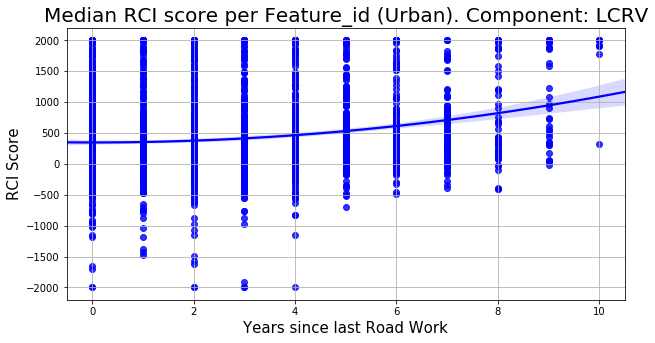

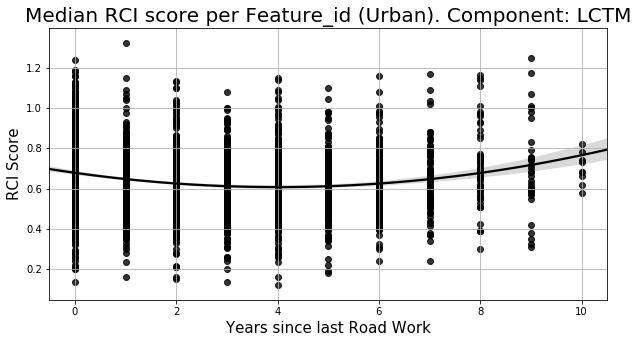

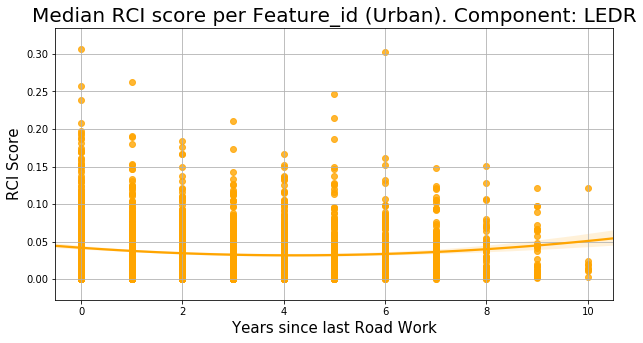

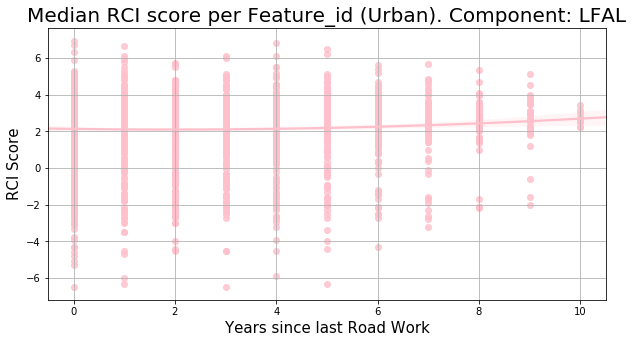

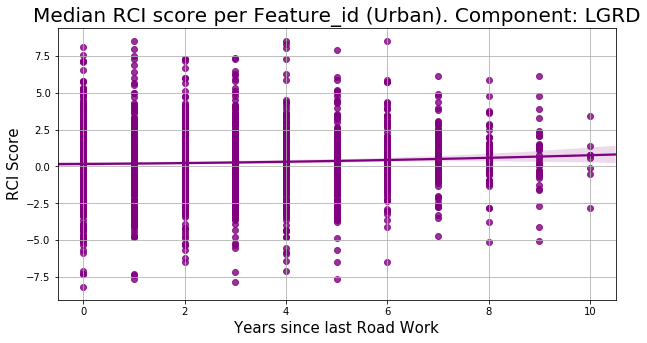

...

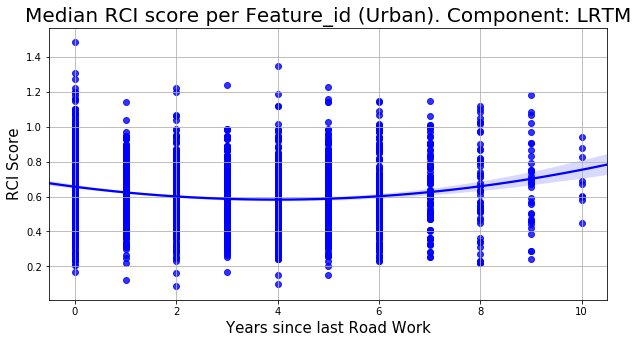

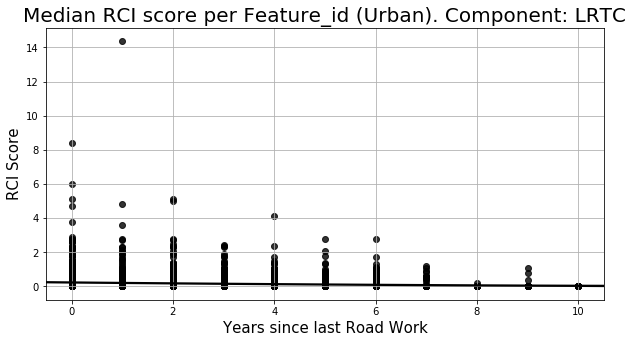

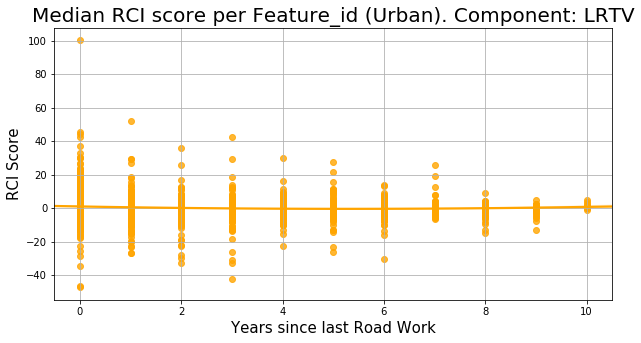

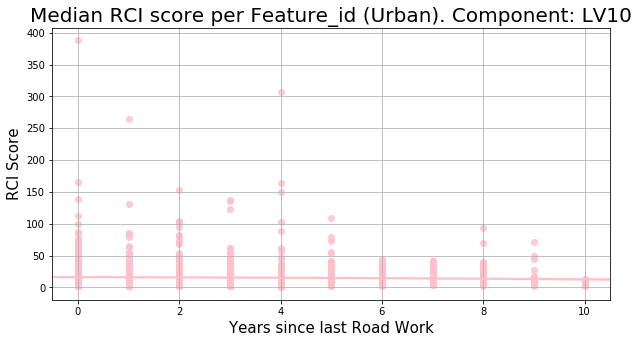

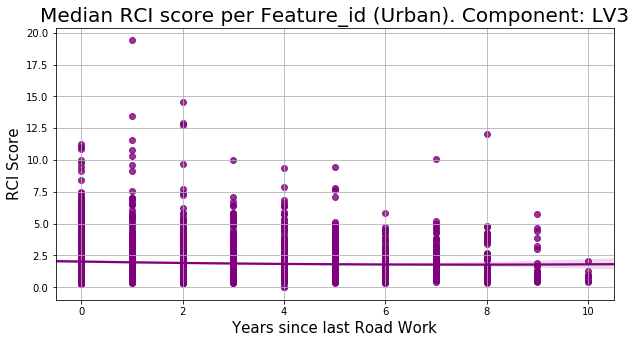

In [106]:
#Plot the RCI scores related to the year after a maintenance work was performed **URBAN
temp = initial.loc[initial['urban_rural']=='Urban']
temp = temp.loc[temp['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']
i = 1
print('The shape of the Rural set is:' + str(len(temp)))
for r in range(-15,0):
    X_fig = temp['Years_since']
    Y_fig = temp.iloc[:,r]
    plt.figure(figsize=(10,5))
    #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
    sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
    plt.grid()
    plt.title("Median RCI score per Feature_id (Urban). Component: " + str(temp.columns[r]),
              fontsize=20)
    plt.xlabel('Years since last Road Work', fontsize=15)
    plt.ylabel('RCI Score', fontsize=15)
    
    i +=1

The shape of the Rural set is:6301


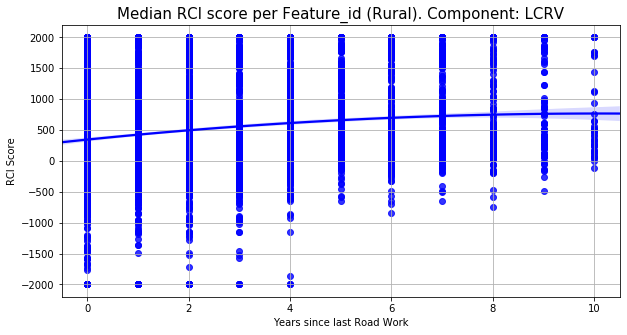

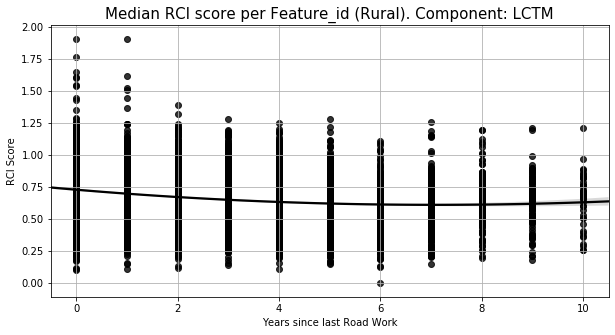

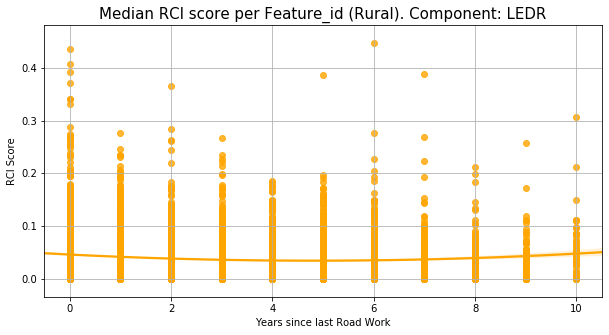

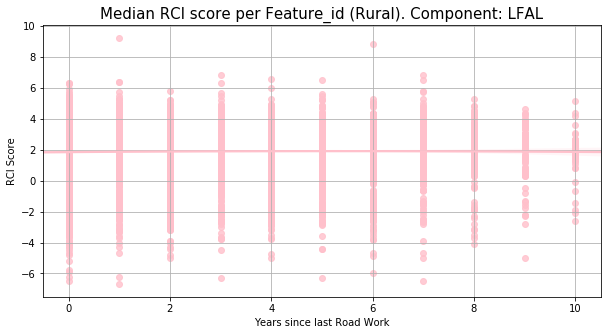

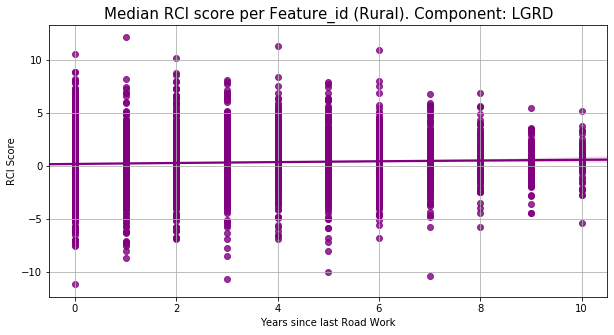

...

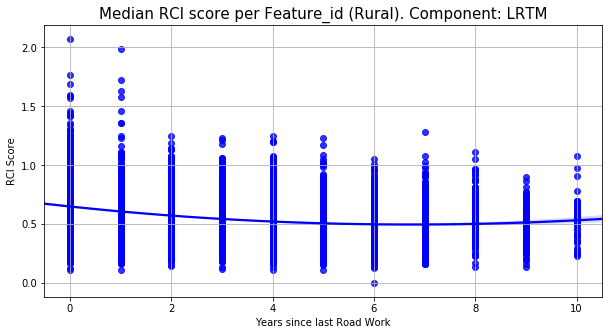

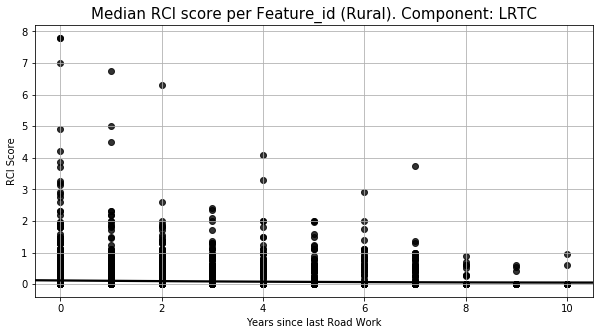

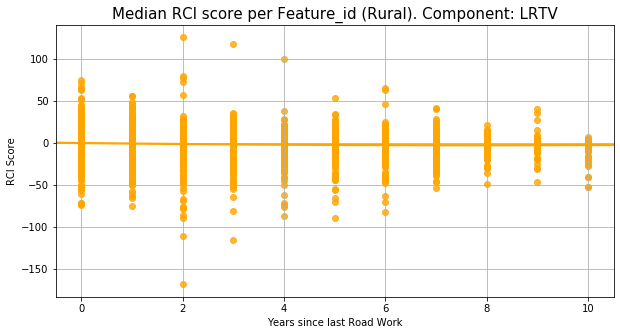

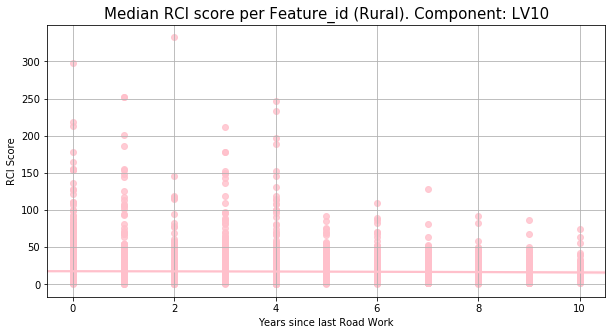

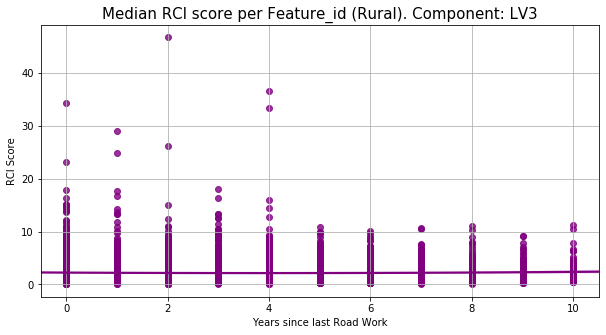

In [107]:
#Plot the RCI scores related to the year after a maintenance work was performed **RURAL
temp = initial.loc[initial['urban_rural']=='Rural']
temp = temp.loc[temp['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']
i = 1
print('The shape of the Rural set is:' + str(len(temp)))
for r in range(-15,0):
    X_fig = temp['Years_since']
    Y_fig = temp.iloc[:,r]
    plt.figure(figsize=(10,5))
    #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
    sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
    plt.grid()
    plt.title("Median RCI score per Feature_id (Rural). Component: " + str(temp.columns[r]),
              fontsize=15)
    plt.xlabel('Years since last Road Work', fontsize=10)
    plt.ylabel('RCI Score', fontsize=10)
    
    i +=1

The shape of the Rural set is:6301
-15
MN Main Distributor
1
(1111,)
-15
SD Secondary Distributor
2
(1559,)
-15
L2 Local Access
3
(1521,)
-15
L1 Local Distributor
4
(1174,)
-15
PR Primary Distributor
5
(936,)
-14
MN Main Distributor
1
(1111,)
-14
SD Secondary Distributor
2
(1559,)
-14
L2 Local Access
3
(1521,)
-14
L1 Local Distributor
4
(1174,)
-14
PR Primary Distributor
5
(936,)
-13
MN Main Distributor
1
(1111,)
-13
SD Secondary Distributor
2
(1559,)
-13
L2 Local Access
3
(1521,)
-13
L1 Local Distributor
4
(1174,)
-13
PR Primary Distributor
5
(936,)
-12
MN Main Distributor
1
(1111,)
-12
SD Secondary Distributor
2
(1559,)
-12
L2 Local Access
3
(1521,)
-12
L1 Local Distributor
4
(1174,)
-12
PR Primary Distributor
5
(936,)
-11
MN Main Distributor
1
(1111,)


C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-11
SD Secondary Distributor
2
(1559,)
-11
L2 Local Access
3
(1521,)
-11
L1 Local Distributor
4
(1174,)
-11
PR Primary Distributor
5
(936,)
-10
MN Main Distributor
1
(1111,)
-10
SD Secondary Distributor
2
(1559,)
-10
L2 Local Access
3
(1521,)
-10
L1 Local Distributor
4
(1174,)
-10
PR Primary Distributor
5
(936,)
-9
MN Main Distributor
1
(1111,)
-9
SD Secondary Distributor
2
(1559,)
-9
L2 Local Access
3
(1521,)
-9
L1 Local Distributor
4
(1174,)
-9
PR Primary Distributor
5
(936,)
-8
MN Main Distributor
1
(1111,)
-8
SD Secondary Distributor
2
(1559,)
-8
L2 Local Access
3
(1521,)
-8
L1 Local Distributor
4
(1174,)
-8
PR Primary Distributor
5
(936,)
-7
MN Main Distributor
1
(1111,)
-7
SD Secondary Distributor
2
(1559,)
-7
L2 Local Access
3
(1521,)
-7
L1 Local Distributor
4
(1174,)
-7
PR Primary Distributor
5
(936,)
-6
MN Main Distributor
1
(1111,)
-6
SD Secondary Distributor
2
(1559,)
-6
L2 Local Access
3
(1521,)
-6
L1 Local Distributor
4
(1174,)
-6
PR Primary Distributor
5
(936,)
-5
MN Main

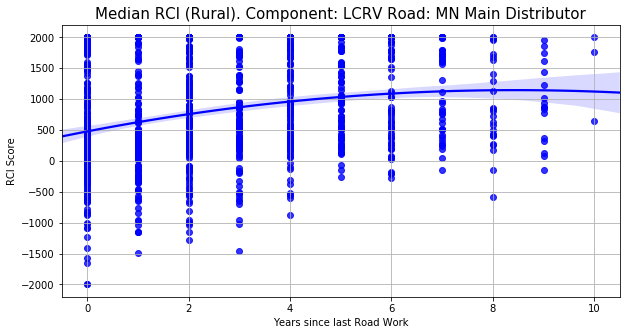

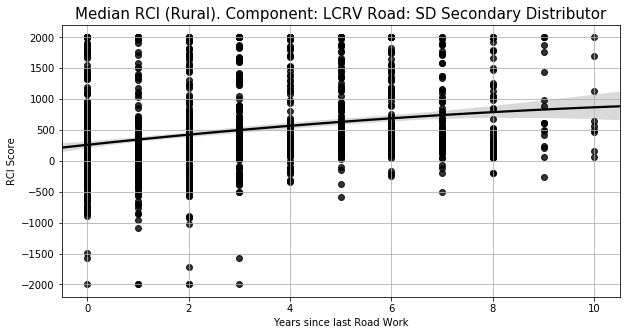

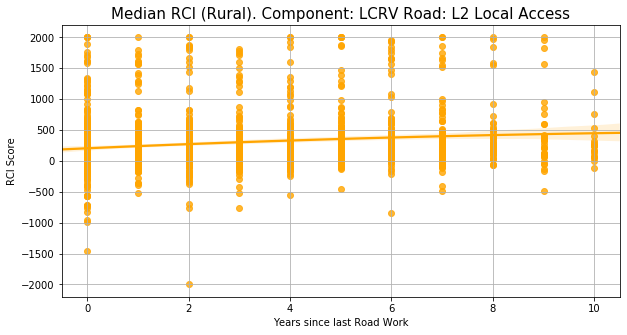

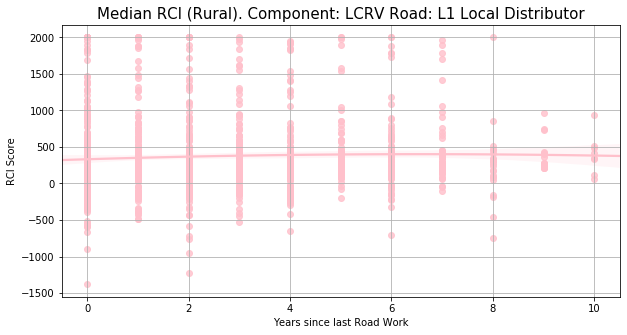

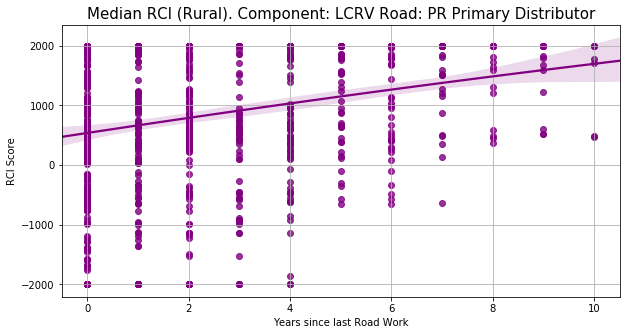

...

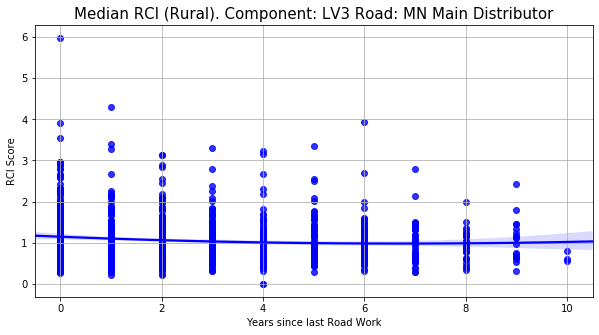

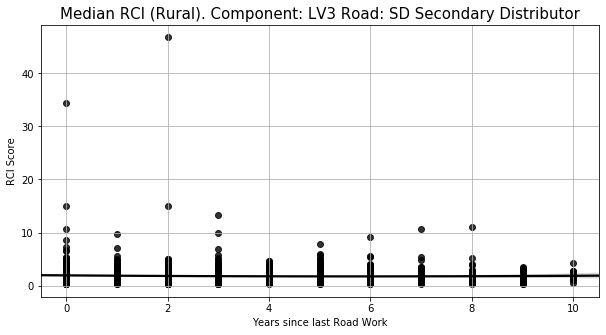

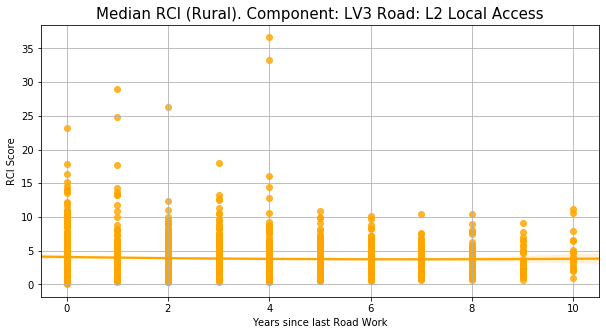

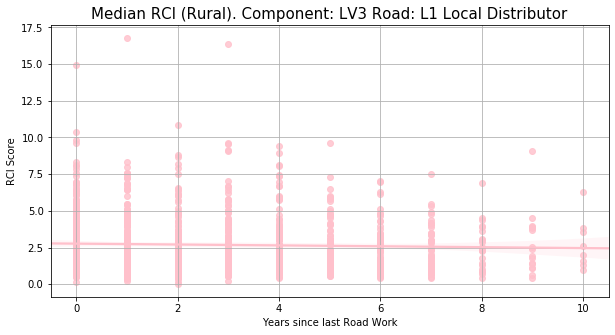

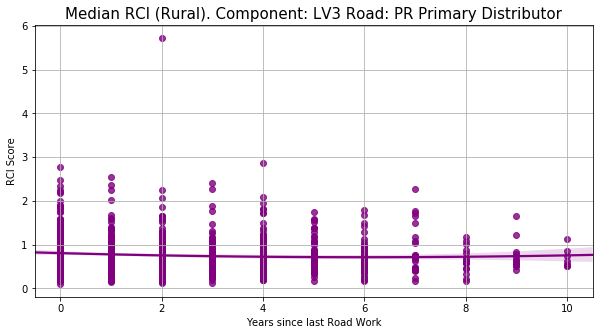

In [118]:
#Plot the RCI scores related to the year after a maintenance work was performed **RURAL PER HIERARCHY
set1 = initial.loc[initial['urban_rural']=='Rural']
hierarchy = initial['hierarchy'].value_counts().index.to_list()
del hierarchy[-1]
set1 = set1.loc[set1['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral', 
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']

print('The shape of the Rural set is:' + str(len(set1)))

for r in range(-15,0):
    i = 1
    for h in hierarchy:
        print(r)
        temp = set1.loc[set1['hierarchy']==h]
        X_fig = temp['Years_since']
        Y_fig = temp.iloc[:,r]
        print(h)
        print(i)
        print(X_fig.shape)
        plt.figure(figsize=(10,5))
        #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
        sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
        plt.grid()
        plt.title("Median RCI (Rural). Component: " + str(temp.columns[r]) + " Road: " + str(h),
                  fontsize=15)
        plt.xlabel('Years since last Road Work', fontsize=10)
        plt.ylabel('RCI Score', fontsize=10)
    
        i +=1

The shape of the Rural set is:2772
-15
MN Main Distributor
1
(1320,)
-15
SD Secondary Distributor
2
(716,)
-15
L2 Local Access
3
(122,)
-15
L1 Local Distributor
4
(439,)
-15
PR Primary Distributor
5
(175,)
-14
MN Main Distributor
1
(1320,)
-14
SD Secondary Distributor
2
(716,)
-14
L2 Local Access
3
(122,)
-14
L1 Local Distributor
4
(439,)
-14
PR Primary Distributor
5
(175,)
-13
MN Main Distributor
1
(1320,)
-13
SD Secondary Distributor
2
(716,)
-13
L2 Local Access
3
(122,)
-13
L1 Local Distributor
4
(439,)
-13
PR Primary Distributor
5
(175,)
-12
MN Main Distributor
1
(1320,)
-12
SD Secondary Distributor
2
(716,)
-12
L2 Local Access
3
(122,)
-12
L1 Local Distributor
4
(439,)
-12
PR Primary Distributor
5
(175,)
-11
MN Main Distributor
1
(1320,)


C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-11
SD Secondary Distributor
2
(716,)
-11
L2 Local Access
3
(122,)
-11
L1 Local Distributor
4
(439,)
-11
PR Primary Distributor
5
(175,)
-10
MN Main Distributor
1
(1320,)
-10
SD Secondary Distributor
2
(716,)
-10
L2 Local Access
3
(122,)
-10
L1 Local Distributor
4
(439,)
-10
PR Primary Distributor
5
(175,)
-9
MN Main Distributor
1
(1320,)
-9
SD Secondary Distributor
2
(716,)
-9
L2 Local Access
3
(122,)
-9
L1 Local Distributor
4
(439,)
-9
PR Primary Distributor
5
(175,)
-8
MN Main Distributor
1
(1320,)
-8
SD Secondary Distributor
2
(716,)
-8
L2 Local Access
3
(122,)
-8
L1 Local Distributor
4
(439,)
-8
PR Primary Distributor
5
(175,)
-7
MN Main Distributor
1
(1320,)
-7
SD Secondary Distributor
2
(716,)
-7
L2 Local Access
3
(122,)
-7
L1 Local Distributor
4
(439,)
-7
PR Primary Distributor
5
(175,)
-6
MN Main Distributor
1
(1320,)
-6
SD Secondary Distributor
2
(716,)
-6
L2 Local Access
3
(122,)
-6
L1 Local Distributor
4
(439,)
-6
PR Primary Distributor
5
(175,)
-5
MN Main Distributor
1
(13

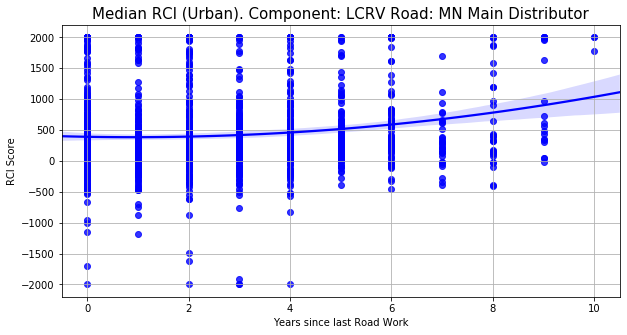

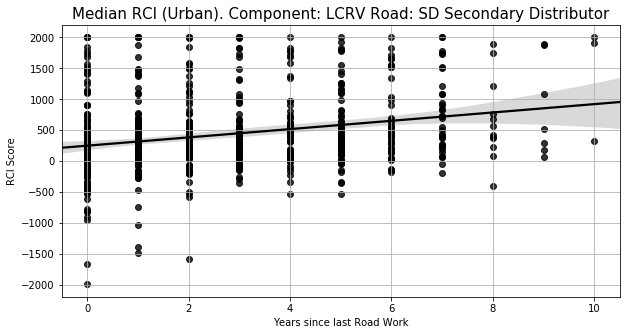

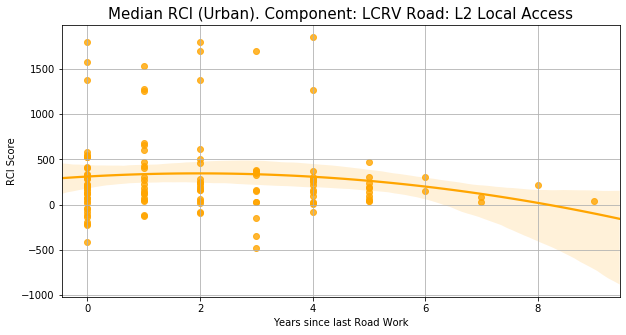

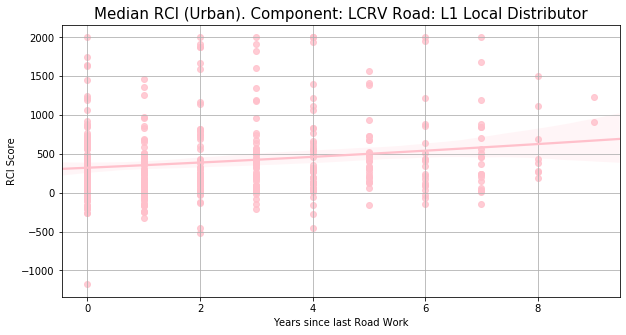

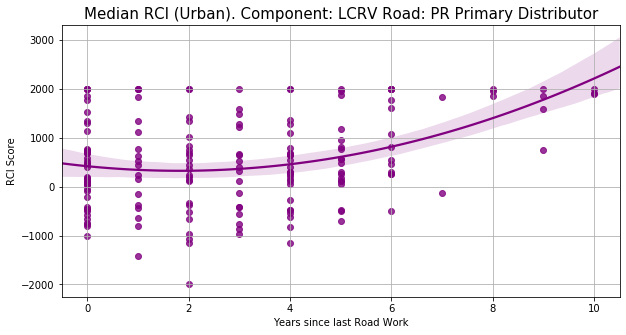

...

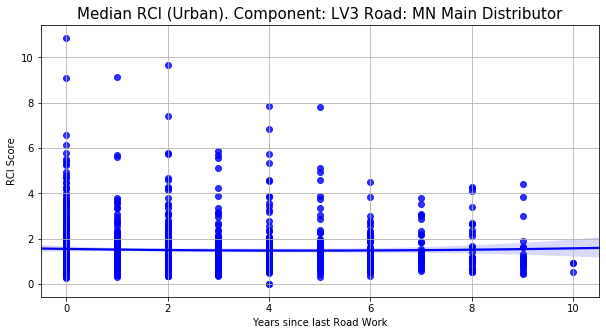

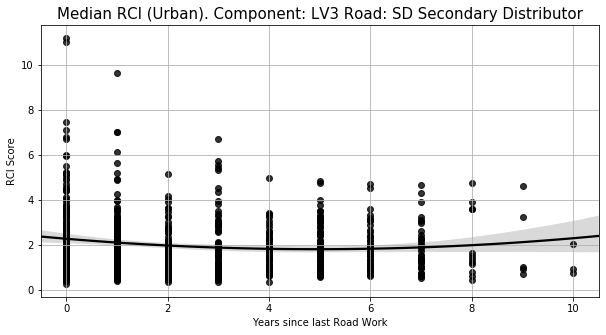

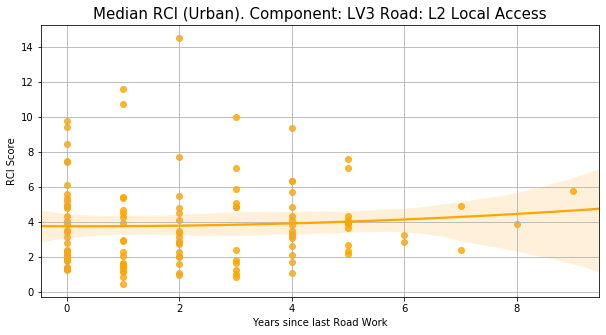

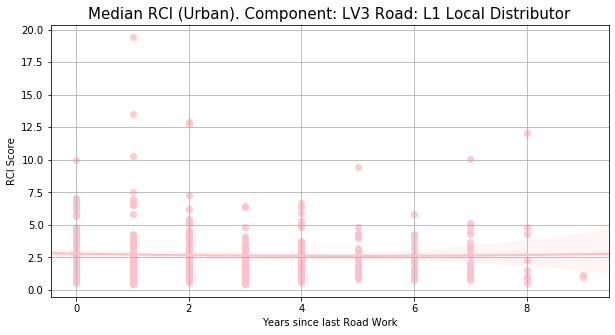

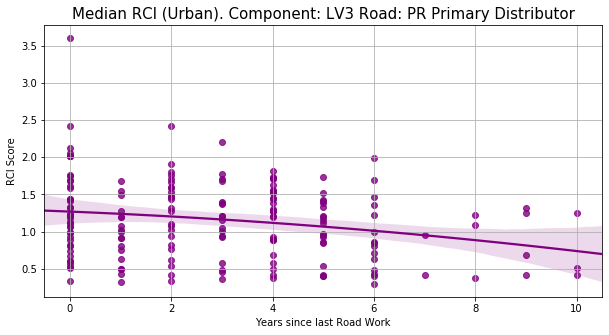

In [119]:
#Plot the RCI scores related to the year after a maintenance work was performed **URBAN PER HIERARCHY
set1 = initial.loc[initial['urban_rural']=='Urban']
hierarchy = initial['hierarchy'].value_counts().index.to_list()
del hierarchy[-1]
set1 = set1.loc[set1['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral', 
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']

print('The shape of the Rural set is:' + str(len(set1)))

for r in range(-15,0):
    i = 1
    for h in hierarchy:
        print(r)
        temp = set1.loc[set1['hierarchy']==h]
        X_fig = temp['Years_since']
        Y_fig = temp.iloc[:,r]
        print(h)
        print(i)
        print(X_fig.shape)
        plt.figure(figsize=(10,5))
        #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
        sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
        plt.grid()
        plt.title("Median RCI (Urban). Component: " + str(temp.columns[r]) + " Road: " + str(h),
                  fontsize=15)
        plt.xlabel('Years since last Road Work', fontsize=10)
        plt.ylabel('RCI Score', fontsize=10)
    
        i +=1

The shape of the Urban set is:1806
-15
MN Main Distributor
1
(927,)
-15
SD Secondary Distributor
2
(470,)
-15
L1 Local Distributor
3
(271,)
-15
PR Primary Distributor
4
(85,)
-15
L2 Local Access
5
(53,)
-14
MN Main Distributor
1
(927,)
-14
SD Secondary Distributor
2
(470,)
-14
L1 Local Distributor
3
(271,)
-14
PR Primary Distributor
4
(85,)
-14
L2 Local Access
5
(53,)
-13
MN Main Distributor
1
(927,)
-13
SD Secondary Distributor
2
(470,)
-13
L1 Local Distributor
3
(271,)
-13
PR Primary Distributor
4
(85,)
-13
L2 Local Access
5
(53,)
-12
MN Main Distributor
1
(927,)
-12
SD Secondary Distributor
2
(470,)
-12
L1 Local Distributor
3
(271,)
-12
PR Primary Distributor
4
(85,)
-12
L2 Local Access
5
(53,)
-11
MN Main Distributor
1
(927,)


C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-11
SD Secondary Distributor
2
(470,)
-11
L1 Local Distributor
3
(271,)
-11
PR Primary Distributor
4
(85,)
-11
L2 Local Access
5
(53,)
-10
MN Main Distributor
1
(927,)
-10
SD Secondary Distributor
2
(470,)
-10
L1 Local Distributor
3
(271,)
-10
PR Primary Distributor
4
(85,)
-10
L2 Local Access
5
(53,)
-9
MN Main Distributor
1
(927,)
-9
SD Secondary Distributor
2
(470,)
-9
L1 Local Distributor
3
(271,)
-9
PR Primary Distributor
4
(85,)
-9
L2 Local Access
5
(53,)
-8
MN Main Distributor
1
(927,)
-8
SD Secondary Distributor
2
(470,)
-8
L1 Local Distributor
3
(271,)
-8
PR Primary Distributor
4
(85,)
-8
L2 Local Access
5
(53,)
-7
MN Main Distributor
1
(927,)
-7
SD Secondary Distributor
2
(470,)
-7
L1 Local Distributor
3
(271,)
-7
PR Primary Distributor
4
(85,)
-7
L2 Local Access
5
(53,)
-6
MN Main Distributor
1
(927,)
-6
SD Secondary Distributor
2
(470,)
-6
L1 Local Distributor
3
(271,)
-6
PR Primary Distributor
4
(85,)
-6
L2 Local Access
5
(53,)
-5
MN Main Distributor
1
(927,)
-5
SD Seconda

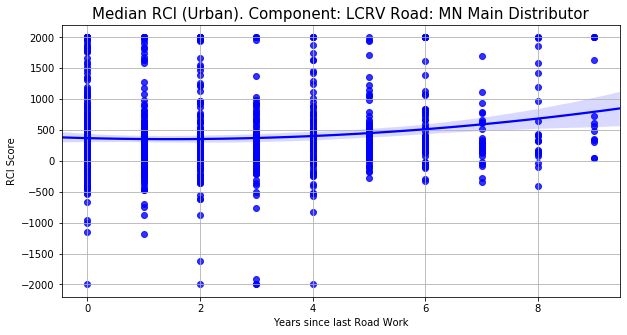

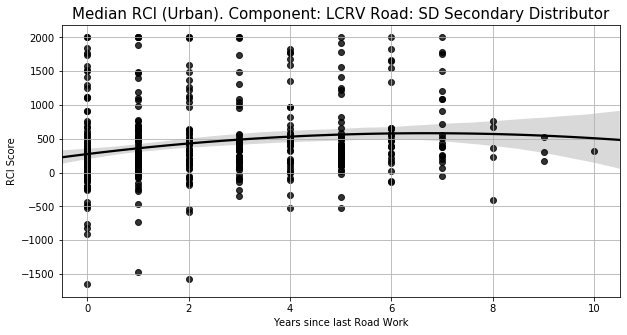

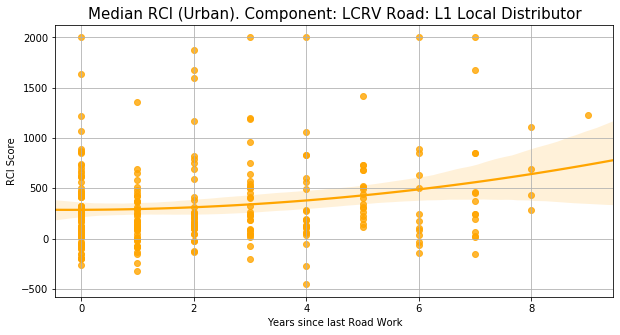

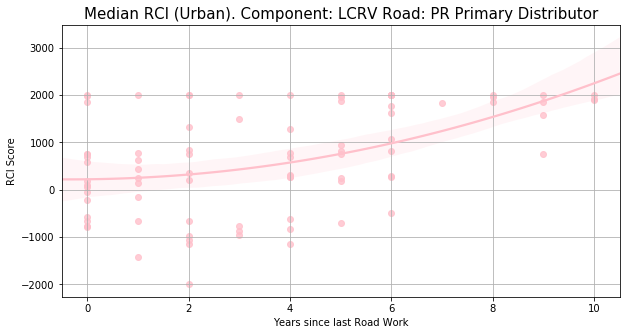

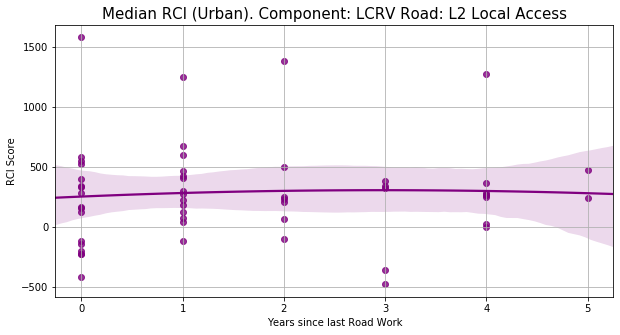

...

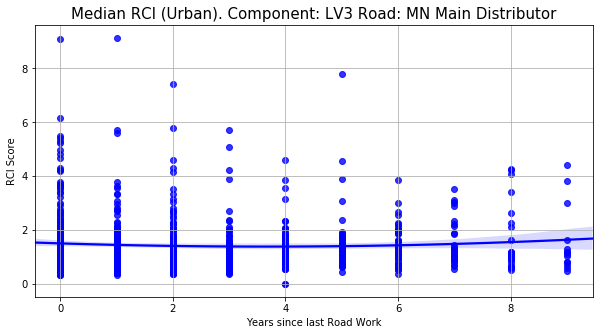

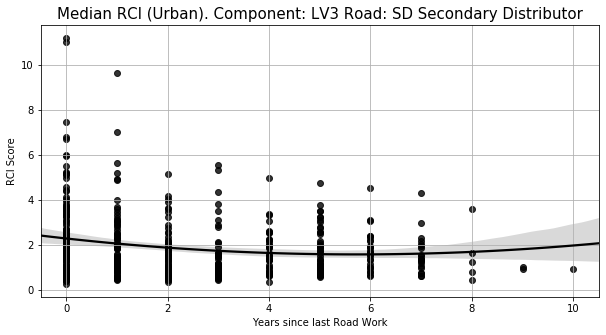

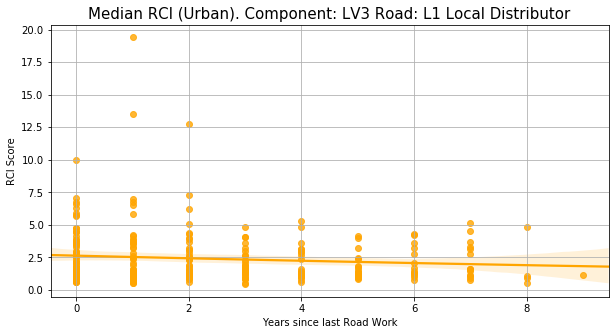

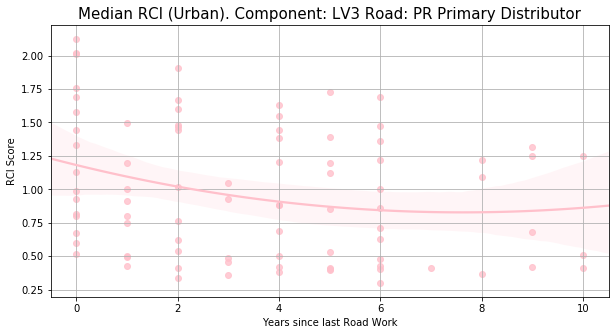

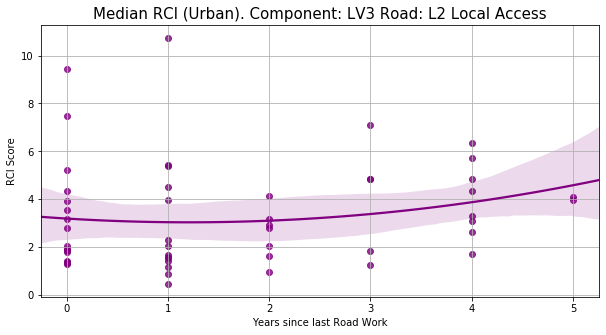

In [123]:
#Plot the RCI scores**URBAN PER HIERARCHY (RESURFACING)
set1 = fr_set.loc[initial['urban_rural']=='Urban']
hierarchy = fr_set['hierarchy'].value_counts().index.to_list()
del hierarchy[-1]
set1 = set1.loc[set1['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral', 
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']

print('The shape of the Urban set is:' + str(len(set1)))

for r in range(-15,0):
    i = 1
    for h in hierarchy:
        print(r)
        temp = set1.loc[set1['hierarchy']==h]
        X_fig = temp['Years_since']
        Y_fig = temp.iloc[:,r]
        print(h)
        print(i)
        print(X_fig.shape)
        plt.figure(figsize=(10,5))
        #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
        sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
        plt.grid()
        plt.title("Median RCI (Urban). Component: " + str(temp.columns[r]) + ", Road: " + str(h),
                  fontsize=15)
        plt.xlabel('Years since last Road Work', fontsize=10)
        plt.ylabel('RCI Score', fontsize=10)
    
        i +=1

The shape of the Urban set is:890
-15
L2 Local Access
1
(77,)
-15
SD Secondary Distributor
2
(236,)
-15
L1 Local Distributor
3
(178,)
-15
MN Main Distributor
4
(328,)
-15
PR Primary Distributor
5
(71,)
-14
L2 Local Access
1
(77,)
-14
SD Secondary Distributor
2
(236,)
-14
L1 Local Distributor
3
(178,)
-14
MN Main Distributor
4
(328,)
-14
PR Primary Distributor
5
(71,)
-13
L2 Local Access
1
(77,)
-13
SD Secondary Distributor
2
(236,)
-13
L1 Local Distributor
3
(178,)
-13
MN Main Distributor
4
(328,)
-13
PR Primary Distributor
5
(71,)
-12
L2 Local Access
1
(77,)
-12
SD Secondary Distributor
2
(236,)
-12
L1 Local Distributor
3
(178,)
-12
MN Main Distributor
4
(328,)
-12
PR Primary Distributor
5
(71,)
-11
L2 Local Access
1
(77,)


C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-11
SD Secondary Distributor
2
(236,)
-11
L1 Local Distributor
3
(178,)
-11
MN Main Distributor
4
(328,)
-11
PR Primary Distributor
5
(71,)
-10
L2 Local Access
1
(77,)
-10
SD Secondary Distributor
2
(236,)
-10
L1 Local Distributor
3
(178,)
-10
MN Main Distributor
4
(328,)
-10
PR Primary Distributor
5
(71,)
-9
L2 Local Access
1
(77,)
-9
SD Secondary Distributor
2
(236,)
-9
L1 Local Distributor
3
(178,)
-9
MN Main Distributor
4
(328,)
-9
PR Primary Distributor
5
(71,)
-8
L2 Local Access
1
(77,)
-8
SD Secondary Distributor
2
(236,)
-8
L1 Local Distributor
3
(178,)
-8
MN Main Distributor
4
(328,)
-8
PR Primary Distributor
5
(71,)
-7
L2 Local Access
1
(77,)
-7
SD Secondary Distributor
2
(236,)
-7
L1 Local Distributor
3
(178,)
-7
MN Main Distributor
4
(328,)
-7
PR Primary Distributor
5
(71,)
-6
L2 Local Access
1
(77,)
-6
SD Secondary Distributor
2
(236,)
-6
L1 Local Distributor
3
(178,)
-6
MN Main Distributor
4
(328,)
-6
PR Primary Distributor
5
(71,)
-5
L2 Local Access
1
(77,)
-5
SD Seconda

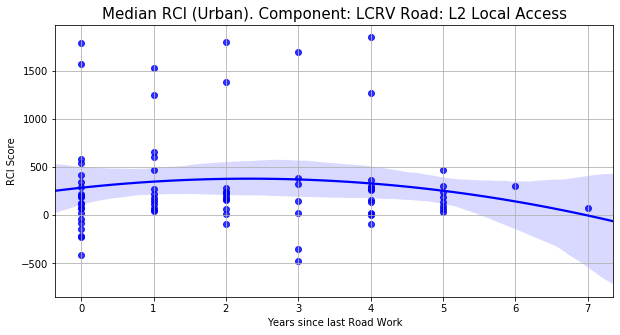

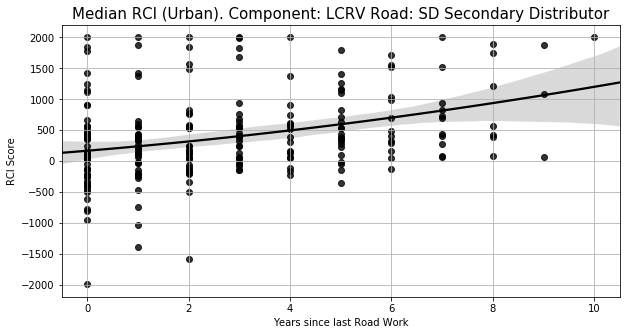

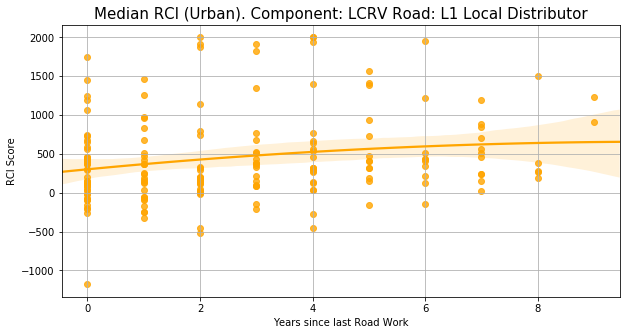

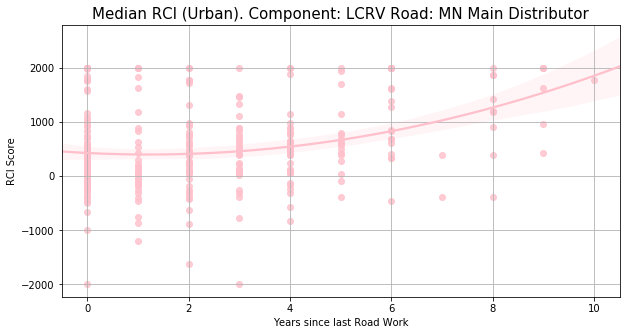

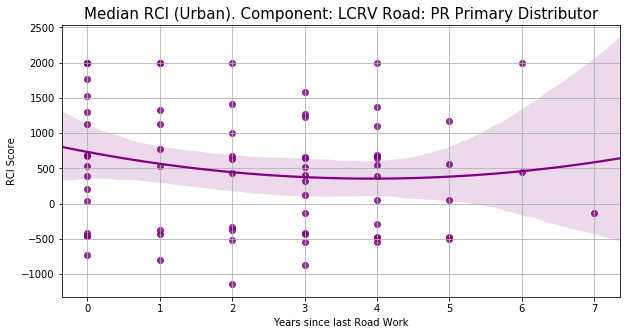

...

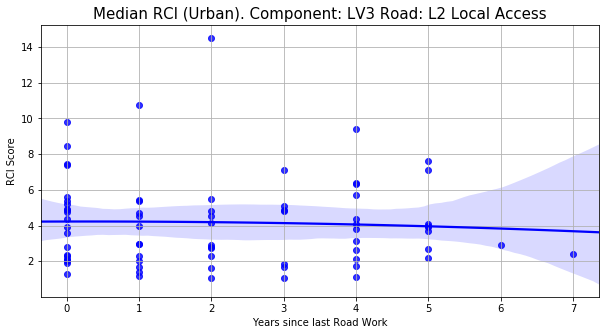

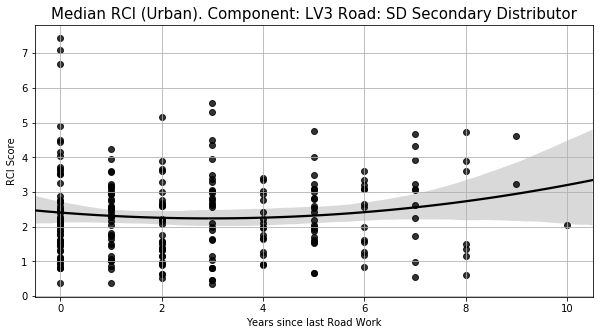

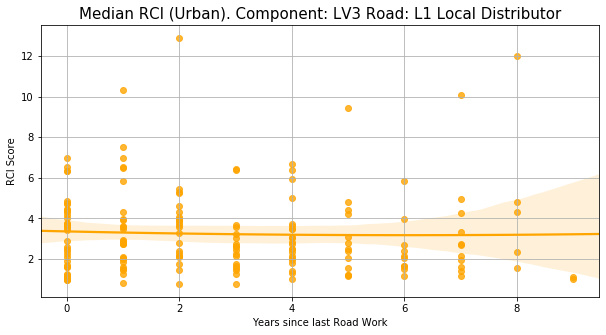

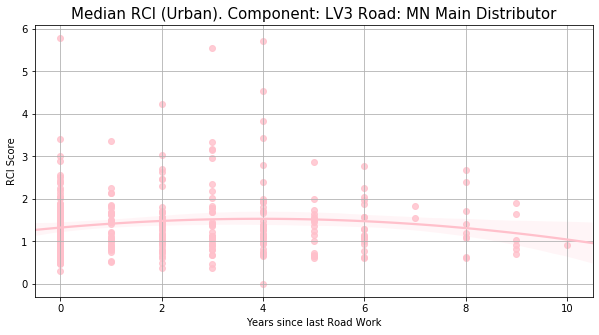

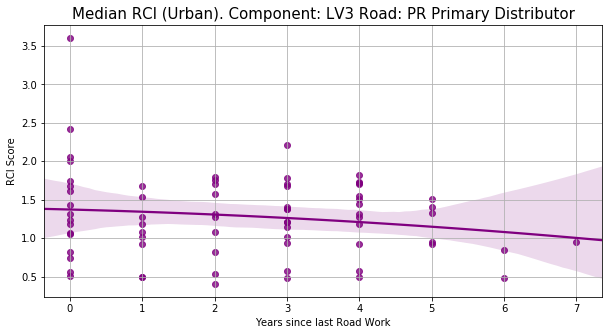

In [124]:
#Plot the RCI scores**URBAN PER HIERARCHY (SURFACE DRESSING)
set1 = fs_set.loc[initial['urban_rural']=='Urban']
hierarchy = fs_set['hierarchy'].value_counts().index.to_list()
del hierarchy[-1]
set1 = set1.loc[set1['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral', 
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']

print('The shape of the Urban set is:' + str(len(set1)))

for r in range(-15,0):
    i = 1
    for h in hierarchy:
        print(r)
        temp = set1.loc[set1['hierarchy']==h]
        X_fig = temp['Years_since']
        Y_fig = temp.iloc[:,r]
        print(h)
        print(i)
        print(X_fig.shape)
        plt.figure(figsize=(10,5))
        #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
        sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
        plt.grid()
        plt.title("Median RCI (Urban). Component: " + str(temp.columns[r]) + " Road: " + str(h),
                  fontsize=15)
        plt.xlabel('Years since last Road Work', fontsize=10)
        plt.ylabel('RCI Score', fontsize=10)
    
        i +=1

The shape of the Rural set is:1792
-15
MN Main Distributor
1
(357,)
-15
SD Secondary Distributor
2
(402,)
-15
L1 Local Distributor
3
(245,)
-15
PR Primary Distributor
4
(510,)
-15
L2 Local Access
5
(278,)
-14
MN Main Distributor
1
(357,)
-14
SD Secondary Distributor
2
(402,)
-14
L1 Local Distributor
3
(245,)
-14
PR Primary Distributor
4
(510,)
-14
L2 Local Access
5
(278,)
-13
MN Main Distributor
1
(357,)
-13
SD Secondary Distributor
2
(402,)
-13
L1 Local Distributor
3
(245,)
-13
PR Primary Distributor
4
(510,)
-13
L2 Local Access
5
(278,)
-12
MN Main Distributor
1
(357,)
-12
SD Secondary Distributor
2
(402,)
-12
L1 Local Distributor
3
(245,)
-12
PR Primary Distributor
4
(510,)
-12
L2 Local Access
5
(278,)
-11
MN Main Distributor
1
(357,)


C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-11
SD Secondary Distributor
2
(402,)
-11
L1 Local Distributor
3
(245,)
-11
PR Primary Distributor
4
(510,)
-11
L2 Local Access
5
(278,)
-10
MN Main Distributor
1
(357,)
-10
SD Secondary Distributor
2
(402,)
-10
L1 Local Distributor
3
(245,)
-10
PR Primary Distributor
4
(510,)
-10
L2 Local Access
5
(278,)
-9
MN Main Distributor
1
(357,)
-9
SD Secondary Distributor
2
(402,)
-9
L1 Local Distributor
3
(245,)
-9
PR Primary Distributor
4
(510,)
-9
L2 Local Access
5
(278,)
-8
MN Main Distributor
1
(357,)
-8
SD Secondary Distributor
2
(402,)
-8
L1 Local Distributor
3
(245,)
-8
PR Primary Distributor
4
(510,)
-8
L2 Local Access
5
(278,)
-7
MN Main Distributor
1
(357,)
-7
SD Secondary Distributor
2
(402,)
-7
L1 Local Distributor
3
(245,)
-7
PR Primary Distributor
4
(510,)
-7
L2 Local Access
5
(278,)
-6
MN Main Distributor
1
(357,)
-6
SD Secondary Distributor
2
(402,)
-6
L1 Local Distributor
3
(245,)
-6
PR Primary Distributor
4
(510,)
-6
L2 Local Access
5
(278,)
-5
MN Main Distributor
1
(357,)
-

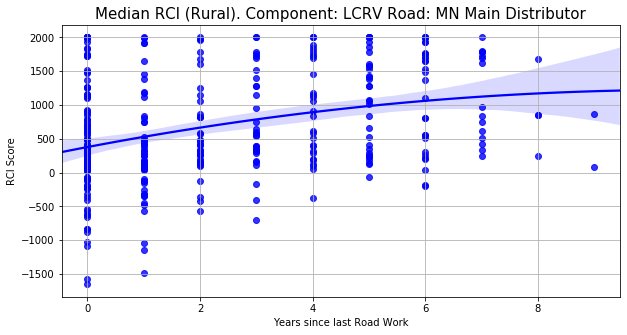

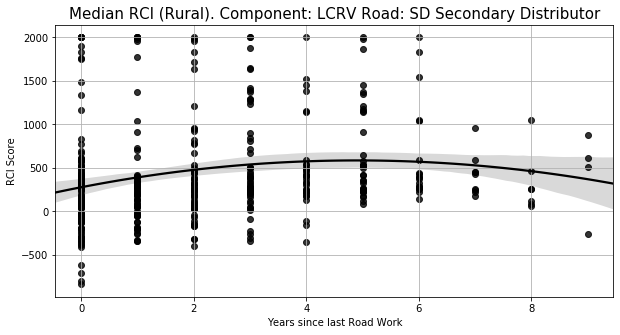

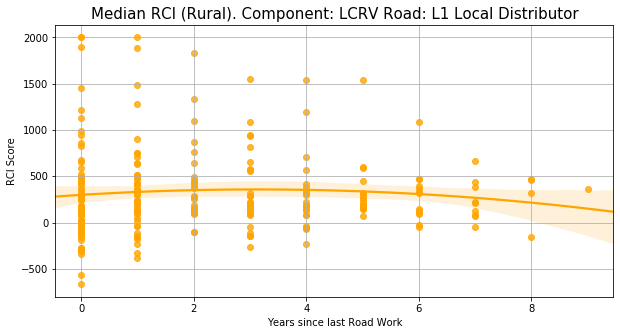

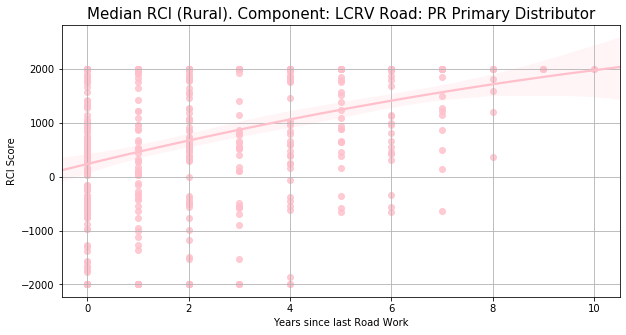

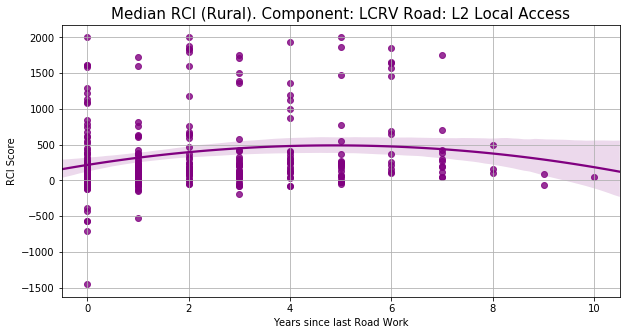

...

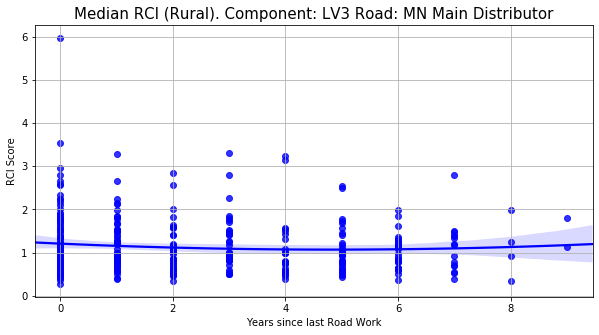

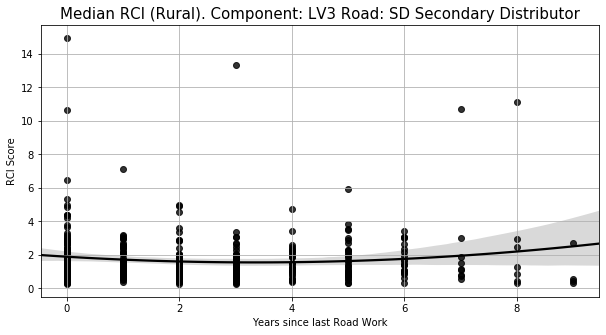

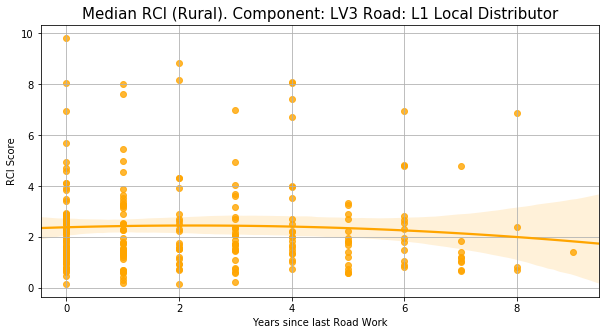

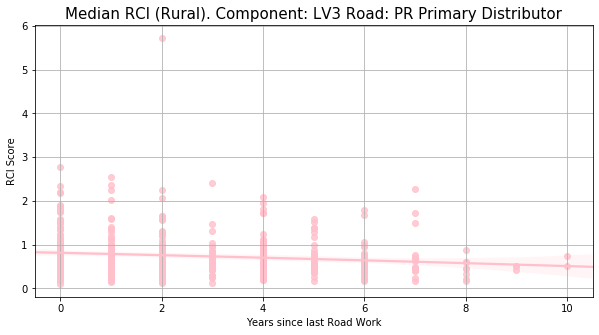

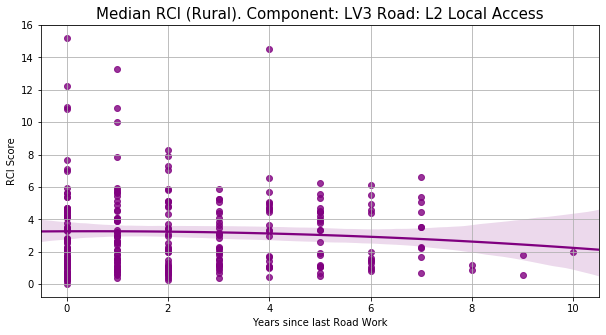

In [125]:
#Plot the RCI scores**RURAL PER HIERARCHY (RESURFACING)
set1 = fr_set.loc[initial['urban_rural']=='Rural']
hierarchy = fr_set['hierarchy'].value_counts().index.to_list()
del hierarchy[-1]
set1 = set1.loc[set1['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral', 
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']

print('The shape of the Rural set is:' + str(len(set1)))

for r in range(-15,0):
    i = 1
    for h in hierarchy:
        print(r)
        temp = set1.loc[set1['hierarchy']==h]
        X_fig = temp['Years_since']
        Y_fig = temp.iloc[:,r]
        print(h)
        print(i)
        print(X_fig.shape)
        plt.figure(figsize=(10,5))
        #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
        sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
        plt.grid()
        plt.title("Median RCI (Rural). Component: " + str(temp.columns[r]) + " Road: " + str(h),
                  fontsize=15)
        plt.xlabel('Years since last Road Work', fontsize=10)
        plt.ylabel('RCI Score', fontsize=10)
    
        i +=1

The shape of the Rural set is:4845
-15
L2 Local Access
1
(1249,)
-15
SD Secondary Distributor
2
(1209,)
-15
L1 Local Distributor
3
(1004,)
-15
MN Main Distributor
4
(764,)
-15
PR Primary Distributor
5
(619,)
-14
L2 Local Access
1
(1249,)
-14
SD Secondary Distributor
2
(1209,)
-14
L1 Local Distributor
3
(1004,)
-14
MN Main Distributor
4
(764,)
-14
PR Primary Distributor
5
(619,)
-13
L2 Local Access
1
(1249,)
-13
SD Secondary Distributor
2
(1209,)
-13
L1 Local Distributor
3
(1004,)
-13
MN Main Distributor
4
(764,)
-13
PR Primary Distributor
5
(619,)
-12
L2 Local Access
1
(1249,)
-12
SD Secondary Distributor
2
(1209,)
-12
L1 Local Distributor
3
(1004,)
-12
MN Main Distributor
4
(764,)
-12
PR Primary Distributor
5
(619,)
-11
L2 Local Access
1
(1249,)


C:\Users\J FernandezGomez\AppData\Local\Continuum\anaconda3\lib\site-packages\ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


-11
SD Secondary Distributor
2
(1209,)
-11
L1 Local Distributor
3
(1004,)
-11
MN Main Distributor
4
(764,)
-11
PR Primary Distributor
5
(619,)
-10
L2 Local Access
1
(1249,)
-10
SD Secondary Distributor
2
(1209,)
-10
L1 Local Distributor
3
(1004,)
-10
MN Main Distributor
4
(764,)
-10
PR Primary Distributor
5
(619,)
-9
L2 Local Access
1
(1249,)
-9
SD Secondary Distributor
2
(1209,)
-9
L1 Local Distributor
3
(1004,)
-9
MN Main Distributor
4
(764,)
-9
PR Primary Distributor
5
(619,)
-8
L2 Local Access
1
(1249,)
-8
SD Secondary Distributor
2
(1209,)
-8
L1 Local Distributor
3
(1004,)
-8
MN Main Distributor
4
(764,)
-8
PR Primary Distributor
5
(619,)
-7
L2 Local Access
1
(1249,)
-7
SD Secondary Distributor
2
(1209,)
-7
L1 Local Distributor
3
(1004,)
-7
MN Main Distributor
4
(764,)
-7
PR Primary Distributor
5
(619,)
-6
L2 Local Access
1
(1249,)
-6
SD Secondary Distributor
2
(1209,)
-6
L1 Local Distributor
3
(1004,)
-6
MN Main Distributor
4
(764,)
-6
PR Primary Distributor
5
(619,)
-5
L2 Local 

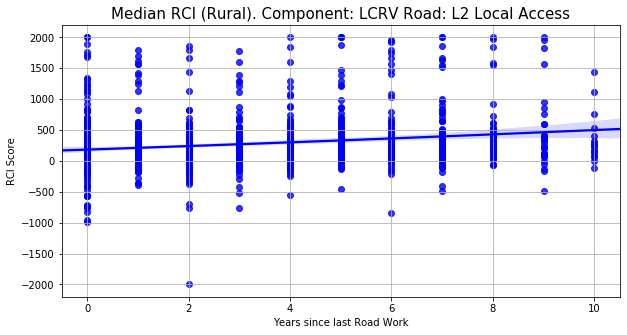

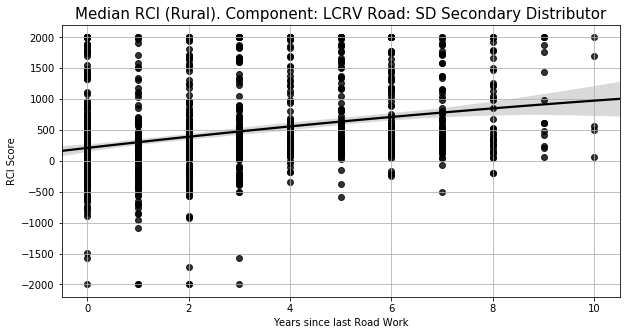

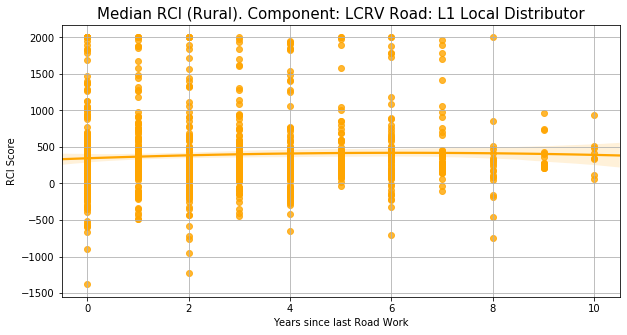

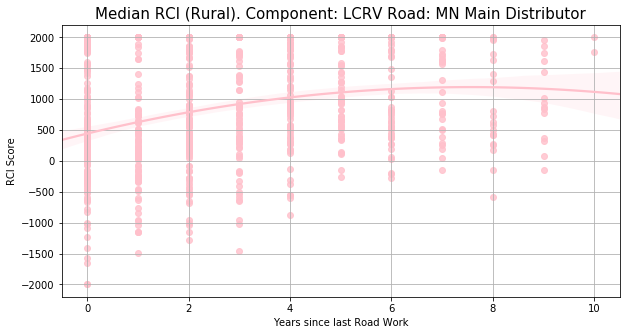

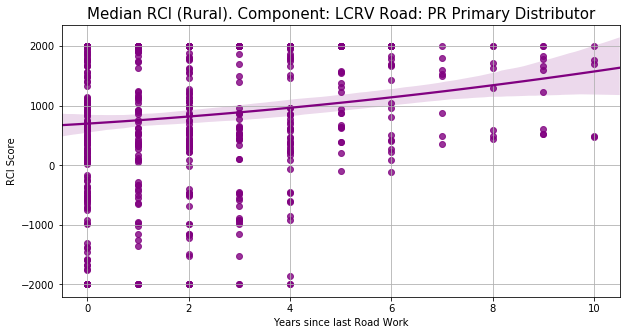

...

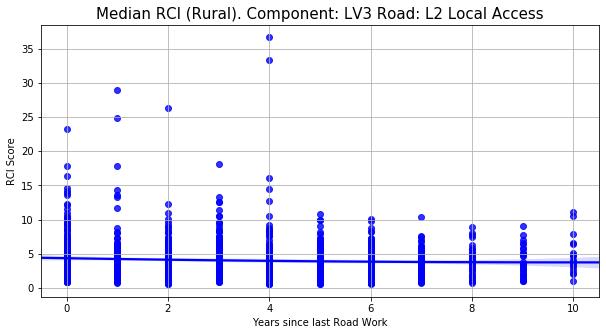

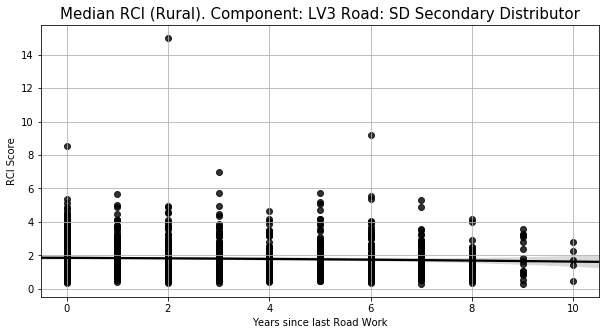

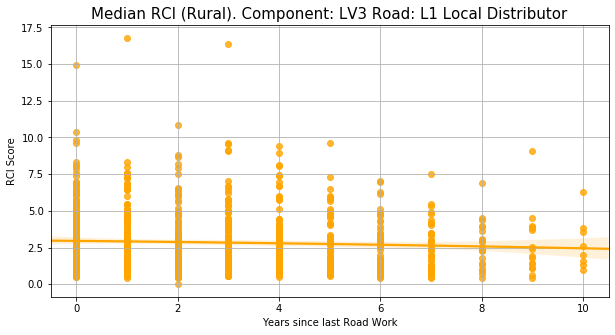

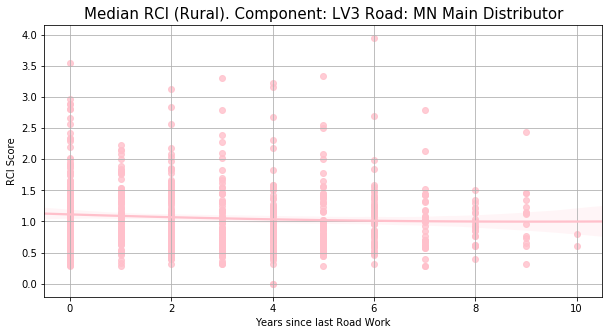

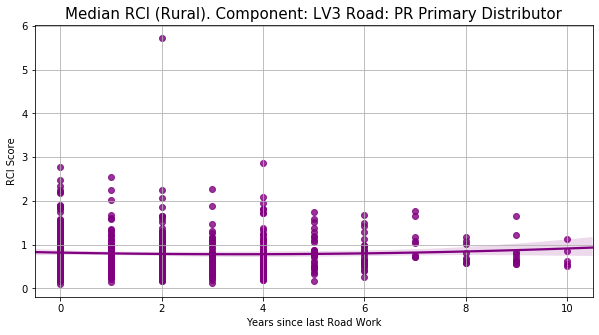

In [126]:
#Plot the RCI scores**RURAL PER HIERARCHY (SURFACE DRESSING)
set1 = fs_set.loc[initial['urban_rural']=='Rural']
hierarchy = fs_set['hierarchy'].value_counts().index.to_list()
del hierarchy[-1]
set1 = set1.loc[set1['Years_since']!=12]
colors = ['white','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral',
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral', 
         'gray','blue', 'black', 'orange', 'pink', 'purple', 'red', 'brown', 'green', 'coral']

print('The shape of the Rural set is:' + str(len(set1)))

for r in range(-15,0):
    i = 1
    for h in hierarchy:
        print(r)
        temp = set1.loc[set1['hierarchy']==h]
        X_fig = temp['Years_since']
        Y_fig = temp.iloc[:,r]
        print(h)
        print(i)
        print(X_fig.shape)
        plt.figure(figsize=(10,5))
        #plt.scatter(X_fig, Y_fig, color='blue', linewidth=3)
        sns.regplot(X_fig, Y_fig, color=colors[i], order = 2)
        plt.grid()
        plt.title("Median RCI (Rural). Component: " + str(temp.columns[r]) + " Road: " + str(h),
                  fontsize=15)
        plt.xlabel('Years since last Road Work', fontsize=10)
        plt.ylabel('RCI Score', fontsize=10)
    
        i +=1

In [127]:
set1.head(900)

,feature_id,FinancialY,sub_obs_val_max,sub_obs_val_std,Carriageway Scheme,Drainage,Drainage CAT 2,Localised Patching,Long Term Structural Maintenance,Major Patching,Microasphalt,Reconstruction,Recycling,Super Cat 2,Surface Dressing,Surface Inlay,Surface Overlay,Surface Preservative,Thin Surfacing,Years_since,CCD1,CCD3,CCD4,CFL,CFS1,CKD2,CKD3,CMD3,CMUD,CPH2,CPH3,CPH4,CPH7,CSH1,DCF1,DCF2,DCF3,DPD1,DPD2,GUL,NZU,PDAM,RICE,SFL,SPL,SPLE,Prev_RCI,SURF,BEDR,Month,hierarchy,distance,road_type_hw,urban_rural,surf_type,width,sub_obs_val_avg,weighted_av,perc85,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3
30,C10/608,2017,60.00,11.907835,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,142.220,TILL,WHCK,4.0,L2 Local Access,308.0,Single 2-Lane Carriageway,Rural,BITM,4.21,3.923793,1.890377,2.7280,2016-10-10 16:54:00.000,1126.520,0.570,0.0080,0.30,1.90,0.90,1.060,0.580,0.760,4.20,0.530,0.00,26.740,14.380,2.010
31,C10/608,2018,130.24,27.257795,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,60.000,TILL,WHCK,0.0,L2 Local Access,308.0,Single 2-Lane Carriageway,Rural,BITM,4.21,40.543448,20.213848,65.0240,2017-10-24 14:41:00.000,1615.550,0.470,0.0040,2.00,-1.00,4.80,0.720,0.410,0.475,1.40,0.550,0.15,-74.970,25.040,3.180
32,C10/608,2019,69.77,13.542418,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,130.240,TILL,WHCK,0.0,L2 Local Access,308.0,Single 2-Lane Carriageway,Rural,BITM,4.21,5.348667,2.195261,9.4155,2018-10-09 13:32:00.000,521.370,0.470,0.0100,1.60,1.70,1.60,0.990,0.560,0.710,2.00,0.330,0.00,-76.400,18.900,2.920
91,B440/110,2019,97.35,24.081826,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,96.020,WHCK,WHCK,8.0,SD Secondary Distributor,1799.0,Single 2-Lane Carriageway,Rural,BITM,7.50,15.216573,22.348657,60.0000,2018-10-13 17:07:00.000,325.730,1.040,0.0620,2.20,0.80,3.80,1.920,1.270,1.560,3.20,1.190,0.00,-1.020,4.260,0.655
95,C40/25,2011,180.00,44.153224,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,140.000,TILL,THAM,9.0,L1 Local Distributor,594.0,Single 2-Lane Carriageway,Rural,BITM,4.74,34.138833,27.818041,80.0000,2010-10-09 15:03:00.000,199.120,0.515,0.0320,3.50,0.80,4.90,0.840,0.470,0.600,3.20,0.480,0.00,1.980,23.460,2.980
96,C40/25,2012,163.00,35.072143,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,180.000,TILL,THAM,0.0,L1 Local Distributor,594.0,Single 2-Lane Carriageway,Rural,BITM,4.74,46.712667,44.178961,80.0000,2011-10-17 23:59:59.000,188.420,0.320,0.0235,2.95,0.60,1.50,0.465,0.250,0.350,0.20,0.290,0.00,0.350,30.220,2.430
97,C40/25,2013,202.51,45.649264,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,163.000,TILL,THAM,0.0,L1 Local Distributor,594.0,Single 2-Lane Carriageway,Rural,BITM,4.74,73.193167,59.749989,115.8310,2013-03-22 23:59:59.000,-253.400,0.265,0.0240,1.10,-0.75,5.05,0.540,0.310,0.415,0.15,0.260,0.00,4.600,115.830,10.845
98,C40/25,2014,157.57,39.902152,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,202.510,TILL,THAM,0.0,L1 Local Distributor,594.0,Single 2-Lane Carriageway,Rural,BITM,4.74,50.657167,54.252701,99.1875,2013-11-15 23:5

In [128]:
feat = 'C74/150'
initial.loc[initial['feature_id']=='C74/150']

,feature_id,FinancialY,sub_obs_val_max,sub_obs_val_std,Carriageway Scheme,Drainage,Drainage CAT 2,Localised Patching,Long Term Structural Maintenance,Major Patching,Microasphalt,Reconstruction,Recycling,Super Cat 2,Surface Dressing,Surface Inlay,Surface Overlay,Surface Preservative,Thin Surfacing,Years_since,CCD1,CCD3,CCD4,CFL,CFS1,CKD2,CKD3,CMD3,CMUD,CPH2,CPH3,CPH4,CPH7,CSH1,DCF1,DCF2,DCF3,DPD1,DPD2,GUL,NZU,PDAM,RICE,SFL,SPL,SPLE,Prev_RCI,SURF,BEDR,Month,hierarchy,distance,road_type_hw,urban_rural,surf_type,width,sub_obs_val_avg,weighted_av,perc85,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3
486,C74/150,2009,121.68,27.648936,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,121.68,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,19.252435,20.782056,48.2670,2008-09-21 23:59:59.000,-586.330,0.490,0.0180,1.50,0.90,5.15,1.030,0.710,0.780,2.70,0.430,0.0,8.220,10.500,0.860
487,C74/150,2011,201.08,37.784937,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,161.38,GSG,LMBE,5.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,28.125526,32.852215,66.7870,NaN,-586.330,0.490,0.0180,1.50,0.90,5.15,1.030,0.710,0.780,2.70,0.430,0.0,8.220,10.500,NaN
488,C74/150,2012,180.00,43.059337,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,201.08,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,26.013362,29.153123,68.2500,2011-12-12 23:59:59.000,-173.845,1.025,0.0265,1.55,0.75,6.30,1.400,0.780,0.950,2.05,0.755,0.0,0.000,9.310,1.075
489,C74/150,2013,174.19,29.984797,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,180.00,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,15.632368,13.434843,31.3045,2013-02-15 23:59:59.000,166.570,0.730,0.0125,3.25,-0.85,6.50,1.360,0.610,0.845,4.15,0.590,0.0,-8.570,8.740,0.990
490,C74/150,2014,151.81,29.936892,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,174.19,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,16.534052,16.234938,46.9450,2013-12-17 23:59:59.000,659.155,0.850,0.0665,1.65,0.45,5.40,1.235,0.660,0.815,1.80,0.625,0.0,-4.385,11.650,0.900
491,C74/150,2015,130.27,27.210279,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,8.0,1.0,3.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,151.81,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,21.895130,21.545358,60.0000,2014-12-22 12:04:00.000,1056.760,0.670,0.0350,3.00,-0.90,4.00,1.270,0.635,0.790,2.30,0.615,0.4,-3.140,9.350,1.060
492,C74/150,2016,121.32,22.052339,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,130.27,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,13.251913,15.187157,37.3000,2016-02-27 16:53:00.000,567.080,0.730,0.0140,1.60,1.05,4.70,1.230,0.640,0.840,1.10,0.605,0.0,-7.095,11.240,0.885
493,C74/150,2017,120.54,26.056593,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,7.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,121.32,GSG,LMBE,0.0,L1 Local Distributor,1151.0,Single 2-Lane Carriageway,Rural,BITM,5.69,17.256174,19.879884,43.6420,2016-09-24 13:13:00.000,

The shape of the curve forC74/150 set is:10


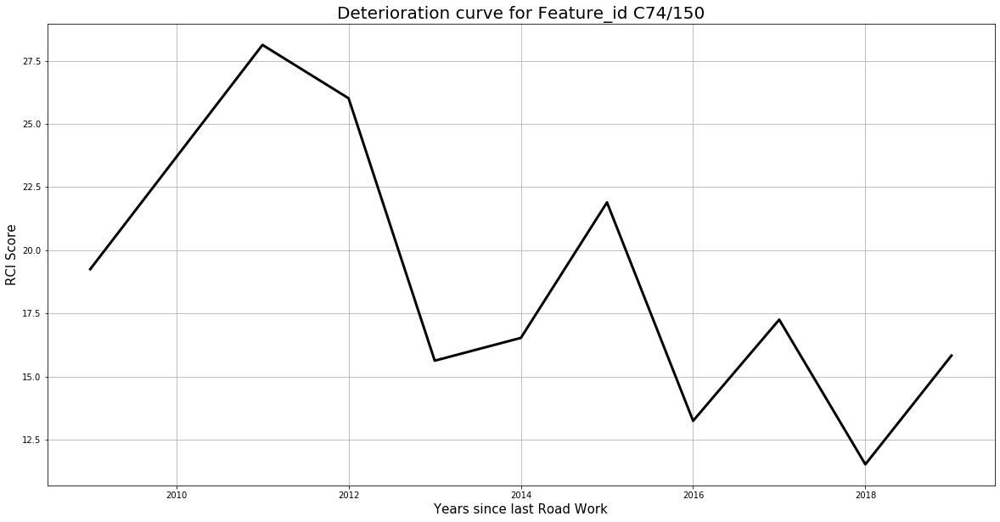

In [129]:
#Define the deterioration curve per individual Feature_Id based on Score, Maintenance Works and Defects
feat_set = initial.loc[initial['feature_id']==feat]
X_fig = feat_set['FinancialY']
Y_fig = feat_set.iloc[:,56]

plt.figure(figsize=(20,10))
plt.plot(X_fig, Y_fig, color= 'black', linewidth=3)
plt.grid()
plt.title("Deterioration curve for Feature_id " + str(feat),
          fontsize=20)
plt.xlabel('Years since last Road Work', fontsize=15)
plt.ylabel('RCI Score', fontsize=15)
print('The shape of the curve for' +  str(feat)+ ' set is:' + str(len(X_fig)))

In [130]:
initial.loc[initial['feature_id']=='A41/002']

,feature_id,FinancialY,sub_obs_val_max,sub_obs_val_std,Carriageway Scheme,Drainage,Drainage CAT 2,Localised Patching,Long Term Structural Maintenance,Major Patching,Microasphalt,Reconstruction,Recycling,Super Cat 2,Surface Dressing,Surface Inlay,Surface Overlay,Surface Preservative,Thin Surfacing,Years_since,CCD1,CCD3,CCD4,CFL,CFS1,CKD2,CKD3,CMD3,CMUD,CPH2,CPH3,CPH4,CPH7,CSH1,DCF1,DCF2,DCF3,DPD1,DPD2,GUL,NZU,PDAM,RICE,SFL,SPL,SPLE,Prev_RCI,SURF,BEDR,Month,hierarchy,distance,road_type_hw,urban_rural,surf_type,width,sub_obs_val_avg,weighted_av,perc85,survey_feat_end,LCRV,LCTM,LEDR,LFAL,LGRD,LLRT,LLTD,LLTM,LLTX,LRRT,LRTM,LRTC,LRTV,LV10,LV3
16624,A41/002,2009,14.59,2.151178,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,14.59,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.317174,0.0,0.0,2008-09-13 23:59:59.000,2000.000,1.09,0.001,2.3,1.50,2.05,1.100,0.980,1.150,2.80,1.110,0.0,7.655,1.81,0.18
16625,A41/002,2010,8.11,1.222629,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,14.59,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.184318,0.0,0.0,2009-10-20 00:00:00.000,1666.670,1.02,0.000,1.8,1.35,1.30,1.300,0.880,1.150,2.85,1.045,0.0,0.635,2.15,0.20
16626,A41/002,2011,10.00,1.054093,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,8.11,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.111111,0.0,0.0,2010-10-11 12:19:00.000,2000.000,1.13,0.000,2.8,1.70,2.40,1.250,1.000,1.190,3.00,1.090,0.0,1.090,1.70,0.18
16627,A41/002,2013,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,5.00,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.000000,0.0,0.0,2012-12-18 23:59:59.000,1732.360,1.11,0.000,2.4,1.40,3.80,1.260,0.960,1.130,1.80,1.140,0.0,-0.080,2.00,0.18
16628,A41/002,2015,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.000000,0.0,0.0,2014-12-14 09:29:00.000,2000.000,1.27,0.066,2.4,1.40,5.50,2.020,1.120,1.380,3.30,1.160,0.0,-1.340,2.91,0.62
16629,A41/002,2017,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.000000,0.0,0.0,2016-09-26 21:41:00.000,1694.300,1.23,0.011,2.3,2.25,3.50,1.925,1.075,1.365,4.75,1.085,0.0,-0.385,2.56,0.39
16630,A41/002,2018,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.000000,0.0,0.0,2017-10-09 16:33:00.000,1944.555,1.15,0.009,2.8,2.00,4.30,1.955,1.070,1.390,5.00,1.035,0.0,0.140,2.49,0.38
16631,A41/002,2019,0.00,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,12.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.00,WHCK,WHCK,0.0,PR Primary Distributor,449.0,Dual 2 Lane,Rural,BITM,10.53,0.000000,0.0,0.0,2018-10-13 13:25:00.000,1911.900,1.25,0.029,2.4,2.25,4.05,2.150,1.255,1.520,4.80,1.105,0.0,-0.120,1.95,0.33
